In this notebook, I will use the lessons learned from het01 and het02 to build a better starting dataset.
In addition, I will also leverage additional information shared by Lukas in regards to species/FROH

In [1]:
%run ../scripts/notebook_settings_lean.py
import glob

The pre-generated stats is in a window size of 1000000, but this can be altered to a different interval if needed.

In [2]:
window_size = 100000

Reading in all windows.

In [3]:
glob_list = glob.glob("../steps/het_stats/temp/*window100000.txt")
df_l = []
import glob
glob_list = glob.glob("../steps/het_stats/temp/*window100000.txt")
for p in glob_list:
    df_l.append(pd.read_csv(p))
    if len(df_l) % 250 == 0:
        print((len(df_l)*100)//len(glob_list), "%")
mb_df = pd.concat(df_l)
mb_df["chrtype"] = ["autosome" if (x != "chrX" and x != "chrY")
                    else "chrY" if x == "chrY" else "chrX" for x in mb_df.chr]

11 %
23 %
35 %
47 %
59 %
71 %
82 %
94 %


In [4]:
mb_df["chrtype"] = ["autosome" if (x != "chrX" and x != "chrY")
                    else "chrY" if x == "chrY" else "chrX" for x in mb_df.chr]

In [3]:
#mb_df.to_csv("../steps/mb_df_03.txt", index=False)
mb_df = pd.read_csv("../steps/mb_df_03.txt")

Creating a metadata frame with as much information as possible

In [4]:
metadata_path ="/home/eriks/primatediversity/data/PGDP_16_7_2020/metadata/"
meta_data_samples = pd.read_excel(metadata_path+"PGDP_md.16.7.2020.xlsx")
meta_data_baboons = pd.read_csv("/home/eriks/baboondiversity/people/eriks/baboon_first_analysis/data/Papio_metadata_with_clustering.txt", sep =" ")
froh_data = pd.read_csv("/home/eriks/primatediversity/people/erik/data/Primate_data_Erik - FROH.csv")
sex_cov = pd.read_csv(metadata_path+"sex_via_coverage_Lukas.csv")

There are some discrepancies, time to understand them.

In [5]:
metadata = pd.merge(meta_data_samples, froh_data, on=["PDGP_ID"])

Lukas informed that the froh data was more up date to, so that is what is going to be used going forward.

In [6]:
metadata = froh_data

Adding sex determination to the samples.

In [7]:
ID_l = []
sex_l = []
for ID in metadata.PDGP_ID:
    ID_l.append(ID)
    if ID in sex_cov.PGDP_ID.values:
        if sex_cov.loc[sex_cov.PGDP_ID == ID].X_over_autosome_ratio.values > 0.8:
            sex_l.append("F")
        else:
            sex_l.append("M")
    elif ID in meta_data_baboons.PGDP_ID.values:
        sex_l.append(meta_data_baboons.loc[meta_data_baboons.PGDP_ID == ID].Sex.values)
    #elif ID in ["PD_0012", "PD_0168", "PD_0169", "PD_0171"]:
    #    sex_l.append("F")
    else:
        sex_l.append("U")
metadata["SEX"] = sex_l

Some samples I have been forced to identify gender for myself - I will not use them for now, as I have gotten an idea for a better treatment of the samples.

In [8]:
metadata.loc[metadata.SEX == "U"]

,PDGP_ID,GENUS,SPECIES,FROH,SEX
11,PD_0012,Saimiri,ustus,0.04070355,U
145,PD_0146,Avahi,laniger,0.00593249,U
146,PD_0147,Avahi,peyrierasi,0.01765451,U
166,PD_0167,Propithecus,coronatus,0.13194422,U
167,PD_0168,Propithecus,diadema,0.13923475,U
168,PD_0169,Propithecus,edwardsi,0.05339238,U
169,PD_0170,Propithecus,perrieri,0.18233462,U
170,PD_0171,Propithecus,tattersalli,0.27053568,U
171,PD_0172,Propithecus,verreauxi,0.04338578,U
175,PD_0176,Saimiri,oerstedii,0.27010458,U


Subsetting so it only uses individuals both in the het data and meatadata.

In [9]:
df_meta_ID = mb_df.loc[mb_df.PGDP_ID.isin(metadata.PDGP_ID.values)]

There are 0 individuals who are lost when using the froh metadata.

In [10]:
len(mb_df.PGDP_ID.unique())

703

In [11]:
len(df_meta_ID.PGDP_ID.unique())

703

Those are:
No one now, but the code used to check was:
mb_df.loc[~mb_df.PGDP_ID.isin(metadata.PDGP_ID.values)].PGDP_ID.unique()

Loading bed files for masking

In [12]:
bed_path = "../data/conservation_beds/{}.bed"
window_size = 100000
df_l = []
for chrom in mb_df.chr.unique():
    df = pd.DataFrame()
    print(chrom)
    chrom_mask = pd.read_csv(bed_path.format(chrom), sep='\t', comment='t', header=None)
    mask_header = ['chrom', 'start', 'end', 'name']
    chrom_mask.columns = mask_header
    mask_percentage_l, window_l, chr_l = [], [], []
    for i in range(0, chrom_mask.end[len(chrom_mask)-1], window_size):
        mask_subset = chrom_mask.loc[(chrom_mask.end >= i) & (chrom_mask.start < i+window_size)]
        if len(mask_subset) == 0:
            mask_percentage_l.append(0)
        else:
            start_sum, end_sum = sum(mask_subset.start), sum(mask_subset.end)
            if mask_subset.start.iloc[0] < i:
                start_sum=start_sum-mask_subset.start.iloc[0]+i
            if mask_subset.end.iloc[-1] > i+window_size:
                end_sum=end_sum-mask_subset.end.iloc[-1]+i+window_size
            mask_percentage_l.append((end_sum-start_sum)/window_size)
        window_l.append(i), chr_l.append(chrom)
    df["mask_percentage"] = mask_percentage_l
    df["window"] = window_l
    df["chr"] = chr_l
    df_l.append(df)
mask_df = pd.concat(df_l)

chr10
chr11
chr12
chr13
chr14
chr15
chr16
chr17
chr18
chr19
chr1
chr20
chr21
chr22
chr2
chr3
chr4
chr5
chr6
chr7
chr8
chr9
chrX
chrY


Adding autosome tag as well as plotting conservation distribution.
Log scale so that magnitudes are more comparable. chrX is in general quite conserved, both compared to chrY and autosomes.

Text(0.5, 1.0, 'Conservation in Megabase windows')

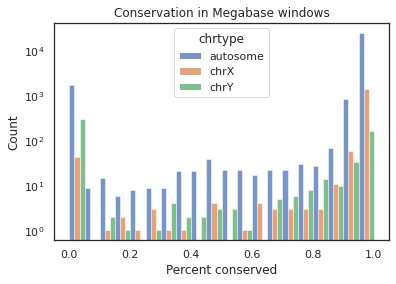

In [13]:
mask_df["chrtype"] = ["autosome" if (x != "chrX" and x != "chrY")
                    else "chrY" if x == "chrY" else "chrX" for x in mask_df.chr]
g = sns.histplot(data=mask_df, x="mask_percentage", hue="chrtype", multiple="dodge", bins=20)
g.set_yscale("log")
g.set_xlabel("Percent conserved")
g.set_title("Conservation in Megabase windows")

Adding conservation status to the dataframe and subsetting to females.

In [14]:
mb_mask = df_meta_ID.merge(mask_df)
mb_females = mb_mask.loc[mb_mask.PGDP_ID.isin(metadata.loc[metadata.SEX == "F"].PDGP_ID)]

In [15]:
mb_females.to_csv("../steps/mb_females_03.txt", index=False)
mb_females = pd.read_csv("../steps/mb_females_03.txt")

In [16]:
mb_masked = mb_mask.loc[mb_mask.mask_percentage > 0.9]
len(mb_masked)/len(mb_mask)

0.921262104739414

In [19]:
mb_females = mb_masked.loc[mb_masked.PGDP_ID.isin(metadata.loc[metadata.SEX == "F"].PDGP_ID)]

Generating summary statistics

I am using a updated approach compared to notebooks 1/2, in which a larger number of statistics are generated by a second loop inside the outer loop. This generates a larger number of summary statistics.
A large part of this could be done more easily with employing a groupby function.
See an example later in this notebook.

In [49]:
IDs = sorted(mb_females.PGDP_ID.unique())

d = {}
d["PDGP_ID"] = []
for s in ["het_std", "het_mean", "het_median", "std", "mean", "median", "cons_windows", "total_windows"]:
    d["aut_"+s] = []
    d["x_"+s] = []
for ID in IDs:
    d["PDGP_ID"].append(ID)
    # Cutoff is based on conservation status.
    cutoff = 0.9
    # Subsetting to only use alt/refmatch data.
    df_s = mb_females.loc[(mb_females.PGDP_ID == ID) &
                          (mb_females.match_type != "nomatch")].reset_index()
    # Summing across alt and refmatch
    alt_ref_df = df_s.set_index(df_s.index//2).sum(level=0)
    alt_ref_df["chrtype"] = (df_s.loc[df_s.match_type == "refmatch"].chrtype).reset_index(drop=True)
    # Normalizing window and mask_percentage columns.
    alt_ref_df["window"] = alt_ref_df.window/2
    alt_ref_df["mask_percentage"] = alt_ref_df.mask_percentage/2
    # Picking out autosomes.
    aut = alt_ref_df.loc[(alt_ref_df.chrtype == "autosome") & (alt_ref_df.mask_percentage >= cutoff)]
    # Calculating core stats. First for sites, then for het sites.
    std, mean, median = aut.GQ_pass.std(), aut.GQ_pass.mean(), aut.GQ_pass.median()
    d["aut_std"].append(std), d["aut_mean"].append(mean), d["aut_median"].append(median)
    std, mean, median = aut.both_pass.std(), aut.both_pass.mean(), aut.both_pass.median()
    d["aut_het_std"].append(std), d["aut_het_mean"].append(mean), d["aut_het_median"].append(median)
    d["aut_cons_windows"].append(len(aut))
    d["aut_total_windows"].append(len(alt_ref_df.loc[(alt_ref_df.chrtype == "autosome")]))
    print(ID, mean, std, median)
    # Calculating quantile normalized by mean het
    for q in [0.05, 0.1, 0.2, 0.3, 0.5, 0.7, 0.9]:
        if "aut_q"+str(q) not in d:
            d["aut_q"+str(q)] = []
        d["aut_q"+str(q)].append(aut.both_pass.quantile(q)/mean)
    x = alt_ref_df.loc[(alt_ref_df.chrtype == "chrX") &
                        (alt_ref_df.window >= 2700000) &
                        (alt_ref_df.mask_percentage >= cutoff)]
    std, mean, median = x.GQ_pass.std(), x.GQ_pass.mean(), x.GQ_pass.median()
    d["x_std"].append(std), d["x_mean"].append(mean), d["x_median"].append(median)
    std, mean, median = x.both_pass.std(), x.both_pass.mean(), x.both_pass.median()
    d["x_het_std"].append(std), d["x_het_mean"].append(mean), d["x_het_median"].append(median)
    d["x_cons_windows"].append(len(x))
    d["x_total_windows"].append(len(alt_ref_df.loc[(alt_ref_df.chrtype == "chrX") &
                                                    (alt_ref_df.window >= 2700000)]))
    for q in [0.05, 0.1, 0.2, 0.3, 0.5, 0.7, 0.9]:
        if "x_q"+str(q) not in d:
            d["x_q"+str(q)] = []
        d["x_q"+str(q)].append(aut.both_pass.quantile(q)/mean)

/home/eriks/miniconda3/envs/baboondiversity/lib/python3.7/site-packages/ipykernel_launcher.py:16: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  app.launch_new_instance()


PD_0001 57.729192453396344 63.01808132195274 37.0
PD_0004 174.76876336221446 135.68259586322998 175.0
PD_0006 93.07209031919282 73.06934796132408 92.0
PD_0007 93.18499624906227 65.59070265878343 88.0
PD_0008 69.22789842841604 89.583041244774 22.0
PD_0010 45.39150819549154 41.855174624118845 39.0
PD_0011 69.11354088522131 81.12164696708366 34.0
PD_0013 85.60969205956266 55.700954580414056 84.0
PD_0014 104.69847342560294 67.29979367800668 105.0
PD_0017 100.18592700948952 73.92309860334407 96.0
PD_0019 33.91110611004839 43.46530867048045 15.0
PD_0020 66.8417163647275 44.414687241108304 72.0
PD_0021 37.8548441543828 44.369816084844516 16.0
PD_0022 35.03401972919245 42.73235154857694 17.0
PD_0023 75.23787554855407 44.07289594849607 78.0
PD_0024 67.58141104984809 44.59132530097477 72.0
PD_0025 130.78789242714078 93.36462684456124 132.0
PD_0026 90.62882112448895 82.10108420432941 83.0
PD_0027 139.14800645137092 91.54490204821953 125.0
PD_0029 178.77185940958026 146.8932360398007 168.0
PD_0030

PD_0332 156.62488278759236 91.23140808917681 157.0
PD_0335 122.00397584486703 81.92614269822626 125.0
PD_0337 120.59052548666591 72.28892827425517 117.0
PD_0341 82.02111698735982 73.64061142861718 80.0
PD_0342 135.14178012827725 73.29921467099496 134.0
PD_0344 69.25726716927348 67.20473148634456 49.0
PD_0345 58.37901804133379 51.87860889486273 51.0
PD_0349 134.1939984996249 76.17248876926689 141.0
PD_0352 93.11117362439518 64.11034785607679 85.0
PD_0353 38.49214208019204 47.79376393536005 20.0
PD_0356 44.94306290086644 57.72411543047739 18.0
PD_0367 31.105097333183302 35.38571808171743 23.0
PD_0369 49.03660777915307 48.03154840899923 38.0
PD_0379 95.4709125689209 86.60836797519605 76.0
PD_0382 68.26191815760849 84.40771716280783 27.0
PD_0387 89.19421627095758 85.59185200320128 69.0
PD_0390 35.59099606077659 52.140619673811415 18.0
PD_0391 30.68614726733936 48.78551855826441 13.0
PD_0392 36.78840742824986 51.9501541091488 19.0
PD_0393 35.74845268014554 49.792204990671706 19.0
PD_0394 35

In [50]:
stats_df = pd.DataFrame(d)
stats_df.to_csv("../steps/het_dataframe_het03.txt", index=False)
stats_df

,PDGP_ID,aut_het_std,x_het_std,aut_het_mean,x_het_mean,aut_het_median,x_het_median,aut_std,x_std,aut_mean,...,aut_q0.5,aut_q0.7,aut_q0.9,x_q0.05,x_q0.1,x_q0.2,x_q0.3,x_q0.5,x_q0.7,x_q0.9
0,PD_0001,63.018081,36.720043,57.729192,23.552577,37.0,10.0,621.180181,529.832590,1924.784479,...,0.640924,1.368458,2.494405,0.000000,0.042458,0.169833,0.424582,1.570953,3.354198,6.113981
1,PD_0004,135.682596,71.276305,174.768763,92.325086,175.0,86.0,184.148183,109.867577,485.748734,...,1.001323,1.464793,2.036977,0.000000,0.010831,0.075819,0.790684,1.895476,2.772811,3.855940
2,PD_0006,73.069348,50.557628,93.072090,54.309966,92.0,45.0,436.187035,351.561684,1319.036758,...,0.988481,1.482722,2.052173,0.000000,0.036826,0.110477,0.644449,1.693980,2.540970,3.516850
3,PD_0007,65.590703,33.997939,93.184996,40.428179,88.0,38.0,73.839571,39.180458,127.203001,...,0.944358,1.223373,1.867253,0.024735,0.098941,1.038879,1.533584,2.176700,2.819815,4.303929
4,PD_0008,89.583041,42.260898,69.227898,22.888660,22.0,3.0,166.486781,119.105699,422.727542,...,0.317791,1.357834,2.961234,0.000000,0.043690,0.087380,0.131069,0.961175,4.106837,8.956400
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
308,PD_0872,83.423714,63.266256,233.195349,115.450859,240.0,115.0,94.145869,69.529095,270.312566,...,1.029180,1.179269,1.389393,0.744906,1.134682,1.507135,1.732339,2.078807,2.381966,2.806389
309,PD_0874,86.060735,63.104962,214.889197,113.142268,224.0,114.0,96.727441,68.716866,247.209415,...,1.042398,1.209926,1.437950,0.327022,0.936874,1.361118,1.617433,1.979808,2.297992,2.731075
310,PD_0876,125.611745,51.845671,165.858895,45.665979,146.0,35.0,169.963830,69.790249,313.476276,...,0.880266,1.302312,1.989643,0.021898,0.503657,1.226296,1.839444,3.197128,4.729998,7.226386
311,PD_0879,58.422499,24.009081,77.568213,39.006873,73.0,38.0,67.605920,31.095335,121.548520,...,0.941107,1.263404,1.882214,0.000000,0.025637,0.717822,1.256189,1.871465,2.512378,3.742930


There are some individuals with very low x_a ratios - a quick check of them.

In [51]:
females = stats_df.loc[stats_df.x_het_mean/stats_df.aut_het_mean > 0.1].PDGP_ID.unique()
stats_df.loc[stats_df.x_het_mean/stats_df.aut_het_mean < 0.1]

,PDGP_ID,aut_het_std,x_het_std,aut_het_mean,x_het_mean,aut_het_median,x_het_median,aut_std,x_std,aut_mean,...,aut_q0.5,aut_q0.7,aut_q0.9,x_q0.05,x_q0.1,x_q0.2,x_q0.3,x_q0.5,x_q0.7,x_q0.9
73,PD_0157,138.243940,81.290986,224.638035,19.739519,219.0,1.0,426.791307,262.007017,925.275169,...,0.974902,1.317675,1.816255,0.455938,1.975732,4.762021,7.092371,11.094495,14.995300,20.669197
74,PD_0158,151.112308,94.649321,255.235193,22.260481,252.0,0.0,423.850849,287.176704,1073.943771,...,0.987325,1.328187,1.774834,0.179691,1.976597,5.121183,7.502084,11.320510,15.228781,20.349964
244,PD_0620,99.415771,61.323084,141.318040,14.036426,129.0,0.0,137.216706,83.855557,209.573433,...,0.912835,1.323256,1.967194,0.569946,1.353621,3.348431,5.343240,9.190374,13.322480,19.805611
287,PD_0818,116.397304,1.926235,245.622431,0.244674,260.0,0.0,146.892716,2.822801,373.958702,...,1.058535,1.262100,1.534876,16.348315,298.356742,617.148876,809.241573,1062.640449,1266.994382,1540.828652
288,PD_0826,126.116279,0.934928,65.530583,0.079861,0.0,0.0,227.516574,1.596905,146.479733,...,0.000000,0.000000,4.440675,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3643.826087
289,PD_0827,118.119023,0.716619,63.334458,0.044397,0.0,0.0,187.618262,1.814133,116.753384,...,0.000000,0.000000,4.357817,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6216.571429
290,PD_0828,134.910439,1.770615,79.853380,0.145833,0.0,0.0,188.763877,2.082884,116.381991,...,0.000000,0.087661,3.932207,0.000000,0.000000,0.000000,0.000000,0.000000,48.000000,2153.142857
291,PD_0829,140.247581,0.748598,85.710993,0.071482,0.0,0.0,189.513485,0.996701,119.385483,...,0.000000,0.781697,3.733477,0.000000,0.000000,0.000000,0.000000,0.000000,937.294737,4476.631579
292,PD_0830,135.053752,0.794190,82.078232,0.082712,0.0,0.0,184.806274,1.223357,115.795680,...,0.000000,0.573843,3.801251,0.000000,0.000000,0.000000,0.000000,0.000000,569.443243,3772.108108
293,PD_0832,140.283970,1.145162,90.055890,0.129201,0.0,0.0,195.675598,2.337571,129.814620,...,0.000000,1.532382,3.553349,0.000000,0.000000,0.000000,0.000000,0.000000,1068.104046,2476.763006


Horizon plot - it is very heavy with 100kb windows

In [1]:
%run ../scripts/notebook_settings_lean.py
from horizonplot import horizonplot

In [3]:
metadata = pd.read_csv("../data/Primate_data_Erik - FROH.csv")
mb_females = pd.read_csv("../steps/mb_females_03.txt")

Transformation to sum and filter based on dataframe type (drop nomatch, sum ref/altmatch)

In [4]:
df_s = mb_females.loc[(mb_females.match_type != "nomatch")].reset_index()
# Summing across alt and refmatch
alt_ref_df = df_s.groupby(["PGDP_ID", "chr", "window"]).sum()
alt_ref_df["mask_percentage"] = alt_ref_df.mask_percentage/2
alt_ref_df = alt_ref_df.reset_index()

Renaming cols for horizonplot

In [5]:
alt_ref_df.rename(columns={"PGDP_ID": "PDGP_ID", "window": "start", "chr": "chrom"}, inplace=True)
total_df = pd.merge(alt_ref_df, metadata, on = "PDGP_ID")

Filling NAs in masked regions

In [6]:
total_df.loc[total_df["mask_percentage"] < 0.95, "both_pass"] = np.nan

Select chrX

In [7]:
sub_df = total_df.loc[(total_df.chrom == "chrX")]

Merge ref and altmatch, take mean and then reset the levels created by groupby.

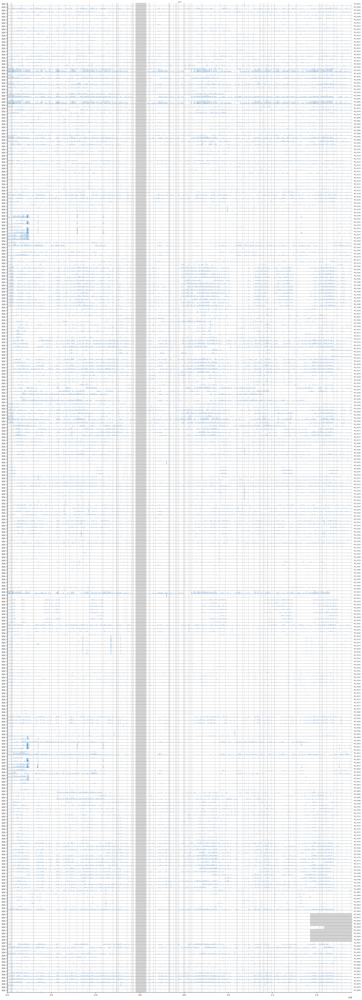

In [119]:
fig = horizonplot(sub_df, 'both_pass', width=2, row='PDGP_ID', size=0.3, aspect=100)

Transforming so we also use negative values in the plot.

In [115]:
median_groupings = sub_df.groupby(["GENUS", "SPECIES", "chrom",
                                   "PDGP_ID"], observed=False)["both_pass"].agg(["median"]).reset_index()
med_df = sub_df.merge(median_groupings, on=["PDGP_ID", "chrom"])
med_df["med_norm"] = (med_df["both_pass"]-med_df["median"])

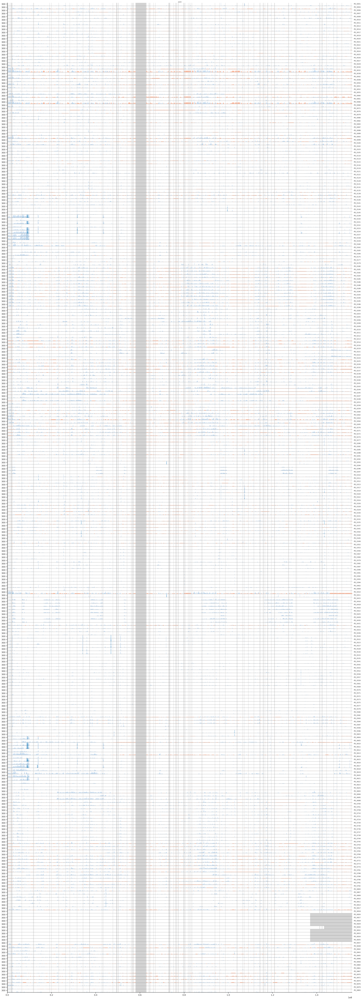

In [117]:
t_df = med_df
fig = horizonplot(t_df, 'med_norm', width=2, row='PDGP_ID', size=0.3, aspect=100)

In this calculation, -1 means that there are no het sites.

In [8]:
mean_groupings = sub_df.groupby(["GENUS", "SPECIES", "chrom",
                                   "PDGP_ID"], observed=False)["both_pass"].agg(["mean"]).reset_index()
mean_df = sub_df.merge(mean_groupings, on=["PDGP_ID", "chrom"])
mean_df["mean_norm"] = (mean_df["both_pass"]-mean_df["mean"])/mean_df["mean"]

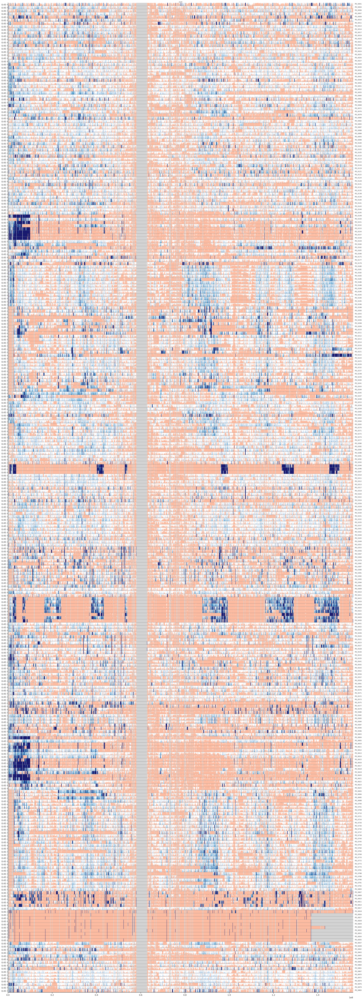

In [127]:
t_df = mean_df
fig = horizonplot(t_df, 'mean_norm', width=2, row='PDGP_ID', size=0.3, aspect=100, cut=1)

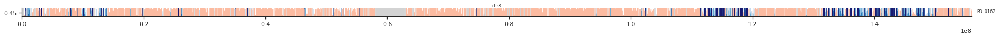

In [9]:
t_df = mean_df.loc[mean_df.PDGP_ID == "PD_0162"]
fig = horizonplot(t_df, 'mean_norm', width=2, row='PDGP_ID', size=0.3, aspect=100, cut=1)

[(-1.0, 5.0)]

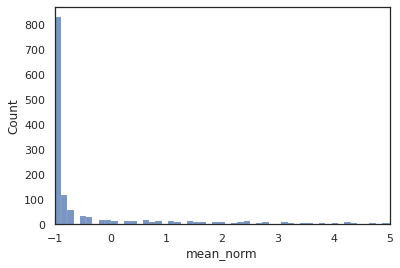

In [16]:
g = sns.histplot(t_df, x="mean_norm")
g.set(xlim=(-1,5))

<AxesSubplot:xlabel='both_pass', ylabel='Count'>

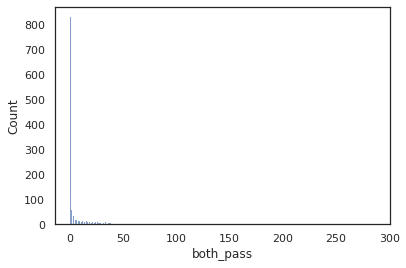

In [11]:
sns.histplot(t_df, x="both_pass")

In [17]:
t_df

,PDGP_ID,chrom,start,index,lines,GQ_pass,ADFrac_pass,both_pass,mask_percentage,GENUS_x,SPECIES_x,FROH,GENUS_y,SPECIES_y,mean,mean_norm
120197,PD_0162,chrX,0,53824908,0,0,0,NaN,0.19703,Mico,argentatus,0.32012686,Mico,argentatus,6.307475,NaN
120198,PD_0162,chrX,100000,53826786,0,0,0,NaN,0.00000,Mico,argentatus,0.32012686,Mico,argentatus,6.307475,NaN
120199,PD_0162,chrX,200000,53828664,266,118,5,NaN,0.76586,Mico,argentatus,0.32012686,Mico,argentatus,6.307475,NaN
120200,PD_0162,chrX,300000,53830542,680,320,5,5.0,0.97249,Mico,argentatus,0.32012686,Mico,argentatus,6.307475,-0.207290
120201,PD_0162,chrX,400000,53832420,339,123,2,2.0,0.99461,Mico,argentatus,0.32012686,Mico,argentatus,6.307475,-0.682916
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
121753,PD_0162,chrX,155600000,56740190,140,36,0,0.0,0.97091,Mico,argentatus,0.32012686,Mico,argentatus,6.307475,-1.000000
121754,PD_0162,chrX,155700000,56742009,177,81,7,7.0,0.96169,Mico,argentatus,0.32012686,Mico,argentatus,6.307475,0.109794
121755,PD_0162,chrX,155800000,56743825,267,132,1,1.0,0.99396,Mico,argentatus,0.32012686,Mico,argentatus,6.307475,-0.841458
121756,PD_0162,chrX,155900000,56745622,266,110,2,2.0,0.99999,Mico,argentatus,0.32012686,Mico,argentatus,6.307475,-0.682916


In [19]:
metadata_path ="/home/eriks/primatediversity/data/PGDP_16_7_2020/metadata/"
meta_data_samples = pd.read_excel(metadata_path+"PGDP_md.16.7.2020.xlsx")

In [21]:
meta_data_samples.loc[meta_data_samples.PDGP_ID == "PD_0162"]

,PDGP_ID,GENUS,SPECIES,AB_QC,COV_QC,REFERENCE_SPECIES,REFERENCE_ASSEMBLY_ID
161,PD_0162,Mico,argentatus,PASS,PASS,Callithrix_jacchus,Callithrix_jacchus.fasta
